# Notes

Note: In the image_classes.json we have "'Fried Kway Teow Mee'" label but in our dialogue.json we have "'fried kway teow mee'" label. We better change one of these before running our evaluation code. 

Note2: Except last note, all labels in dialogue.json (included in img_gts field) has the same label as image_classes.json files.

Note3: we have one class, named "bird flock", that has only one picture. It, however, has not appeared in dialogue.json file. All other classes has atleast 4 images and on average they have "274.031746031746" files and we have 315 classes in image_classes file. 

Note4: Images that user has sent in dialogue file already exist in our images.tar.zip dataset. So, based on note3, we can exclude that image from our image search with CLIP and see if the nominated! image, the best retrieved image, has the same label as the label included in image_classes.

----------
+ Notes for the structure of dialogue.json and how images are exchanged between user and agent and ...  ==>>
-----------
When user sends image:
+ They ask to find a domain (hotel,food,restaurant ,...) based on a image
+ I think Agent just rely on finding similarity between user pics and pictures in the dataset not their own knowledge or comments for that restaurant or ...
+ They way that users ask is in this form (like those, this, like this image/picture) but we can simply wait 10 seconds to see if users send any image or not
+ Un/fortunately images that users send exist in our venue dataset for the correspnding image
+ Id '2508' user looks for a name of a food not a Venue name
+ Id 2582; user send multiple images (agent can do too)
+ ID 3100; User might ask for a hotel near a river similar to sent picture by the user! 

-------- 

When Agent sends image:
+ ID 2601: there is not informative information in current bstate, we can refer to previous bstates.
+ ID "2370": user asks for a restaurant with "outdoor" settings. then agnet find the restaurant with their own knowledge and then even recommend the cooktails of that restaurant. (NOTE: I thing the agent find the information either with their own knowledge or from reviews and informaitons about venues in our db.json)
+ User ask agent for some image from that venues/food and then agent send some images based just on their own preference (here we might can use "img_gts" label(s) )
+ ID 2891: the only informaiton that helps us to retrieve the best image is the users' action from previous turn(previous the the current turn that we want to send an image). Interetingly in this case, user ask for a "quiet" palce that is not searchable, I believe :). In addition, user asks for tea but the agent send a picture of a teapot. I think here our "ConceptNet" method works better than CLIP algorithm
+ User asks for many things. then agent send two images, first one is related to user's request (near river) and second one is agent's recommendation (related to bicycle)
+ ID "4902": Agent sends images when there is no need to send image!
+ iD 3641: agent send an image which no one can know why that image!
+ ID 4826: "user: sure, i'd like to have a picture of the building in case i get lost."

.




.

----------
+ Notes for the information about our files (images and classes and domains and corresponding venue name)  ...  ==>>
-----------
We have 113560 Images in our image.tar.zip file 

We have 86320 images in our image_classes.json file. All of them have only one class assigned.

we have 27357 images in db.json that does not exist in our imge_classe.json file. 276 of db.json images that do exist in our image_classes.json have appeared in more for more than one Venuename, perhaps only for two venues.

There are 27247 images in images.tar.zip which does not have class

There are 7 images in image_classes.json which are not in imges.tar.zip




# Libs & Constants

In [ ]:
%%capture
!pip install --upgrade --no-cache-dir gdown


In [ ]:
%pylab inline
import matplotlib.pyplot as plt
from PIL import Image
BASE = "/content/Image/"

Populating the interactive namespace from numpy and matplotlib


In [ ]:
import json

# Download MMConv dialogues and images.zip

In [ ]:
%%capture
!git clone https://github.com/liziliao/MMConv

In [ ]:
%%capture
!pip install --upgrade --no-cache-dir gdown

In [ ]:
%%capture
!gdown --id 1gjt41sJYm3afzghUphNIkwQeeOPsxn52
!tar -xvf  MMConv_Image.tar.gz -C /content/

# Image EDA


## loading data 

In [ ]:
import json
 
# Opening JSON file
f = open('/content/MMConv/dataset/dialogues.json',)
 
# returns JSON object as
# a dictionary
data = json.load(f)
 
# Iterating through the json
# list
#for i in data['emp_details']:
#    print(i)
 
# Closing file
#f.close()

## Exploring data set

In [ ]:
"""" open span: image": "request """
list_of_key = data.keys()
print(len(list_of_key),"\n", type(list_of_key))

5106 
 <class 'dict_keys'>


In [ ]:
print(list_of_key)

dict_keys(['105', '108', '109', '110', '112', '113', '116', '117', '118', '119', '120', '124', '125', '128', '130', '132', '138', '139', '140', '141', '142', '143', '144', '145', '146', '147', '153', '154', '155', '156', '157', '158', '159', '160', '161', '162', '163', '164', '165', '167', '168', '170', '171', '172', '173', '175', '177', '178', '179', '180', '181', '182', '183', '184', '185', '186', '188', '189', '190', '192', '193', '194', '195', '196', '197', '198', '199', '200', '201', '202', '204', '205', '207', '208', '209', '210', '211', '213', '215', '217', '219', '220', '222', '224', '225', '226', '227', '229', '230', '231', '232', '233', '234', '235', '236', '237', '238', '239', '240', '241', '242', '243', '244', '245', '246', '247', '248', '249', '250', '251', '252', '253', '254', '255', '256', '257', '258', '259', '260', '261', '262', '263', '264', '265', '266', '267', '268', '269', '270', '272', '273', '275', '276', '277', '278', '279', '280', '281', '282', '283', '284', '2

In [ ]:
ids_with_agent_image = []
ids_with_user_image = []
ids_with_bothsides_image = []
agent_image_recom = []
agent_image_not_recom = []

In [ ]:

flag = [True]
for id, dialogue in data.items():
  for turn in dialogue['dialogue']:
    if turn['agent']['imgs'] != []:
      flag[0] = True
      ids_with_agent_image.append((id,turn['turn idx']))
      for k,v in turn['agent']['dialog_act'].items():
        if v == "recommend":
          agent_image_recom.append((id,turn['turn idx']))
          flag[0]= False
          break
          # break; since we can have multiple recomms
      if flag[0]:
        agent_image_not_recom.append((id,turn['turn idx']))
    if turn['user']['imgs'] != []:
      ids_with_user_image.append((id,turn['turn idx']))


In [ ]:
tmp = [j[0] for j in ids_with_agent_image]
ids_with_bothsides_image = [i[0] for i in ids_with_user_image if i[0] in tmp] 

In [ ]:
ids_with_bothsides_image = set(ids_with_bothsides_image)

In [ ]:
len(ids_with_agent_image),len(ids_with_user_image),len(ids_with_bothsides_image),len(agent_image_recom)

(4175, 2683, 800, 2030)

In [ ]:
set_ids_with_agent_image = set([j[0] for j in ids_with_agent_image])
set_ids_with_user_image = set([j[0] for j in ids_with_user_image])

In [ ]:
tp = [ i for i in set_ids_with_agent_image if i in set_ids_with_user_image ]
len(tp)

800

In [ ]:
set_agent_image_not_recom = set([i[0] for i in agent_image_not_recom])
set_agent_image_recom = set([i[0] for i in agent_image_recom])

In [ ]:
len(set_ids_with_agent_image),len(set_ids_with_user_image),len(ids_with_bothsides_image),len(agent_image_recom)

(2929, 2229, 800, 2030)

In [ ]:
len(set_agent_image_not_recom), len(set_agent_image_recom)

(1720, 1560)

In [ ]:
len( set(list(set_agent_image_not_recom)+list(set_agent_image_recom)))

2929

In [ ]:
for tup in agent_image_recom:
  if tup[0] == '190':
    print(tup)

print(11111111111111)
for tup in agent_image_not_recom:
  if tup[0] == '190':
    print(tup)

('190', 3)
('190', 7)
11111111111111
('190', 4)


In [ ]:
2929 + 2229 - 800

4358

In [ ]:
import random as rd
print(rd.sample(set_ids_with_user_image,20))

['1775', '6224', '1580', '1528', '5470', '3465', '5965', '4880', '1570', '883', '3240', '2453', '4532', '6294', '3733', '1475', '3633', '2915', '2998', '1175']


In [ ]:
import random as rd
print(rd.sample(set_ids_with_agent_image,20))

['5654', '6558', '1841', '5015', '3964', '5872', '6685', '211', '6475', '4181', '3519', '3236', '436', '3459', '4109', '2023', '2400', '5512', '4078', '2665']


## Image dataset

In [ ]:
# Agent_sample = 
['3924', '6662', '2601', '2370', '3962', '1823', '2891', '4373', '1150', '3798',
'4329', '4902', '6220', '3641', '3794', '4759', '4021', '5393', '427', '4826']


In [ ]:
# user_sample = 
['2710', '1683', '434', '6476', '3778', '622', '4114', '3729', '2508','1850',
'2582', '3100', '6651', '1776', '3432', '4517', '6529', '2732', '1093', '139']

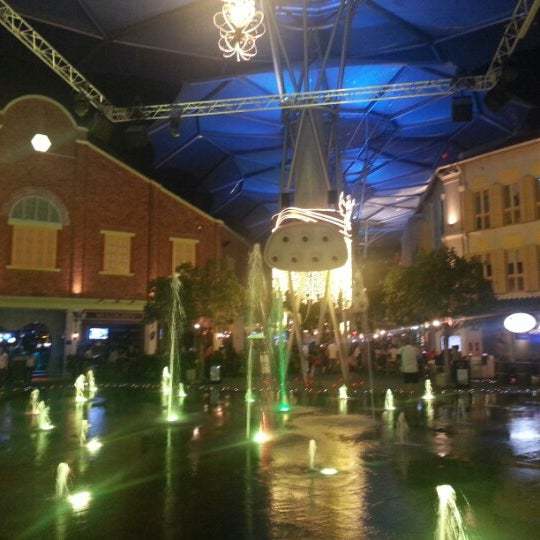

In [ ]:
# "18eec61131813d3cf47d4d0e7776fa44.jpg"
add = BASE + "c595d999887966534bf8b07812797155.jpg"
im = Image.open(add) 
im

In [ ]:
  hillv2 =  [
            "76ae9a16005b9f9dac0ca89c394fdef4",
            "19857425b457cb3973f6bcdf5753dc59",
            "477ced9d4f3836f2da3d1b0823140a42",
            "394f29fc16ff3c09cb7bbd1fcfbf797e"
        ]

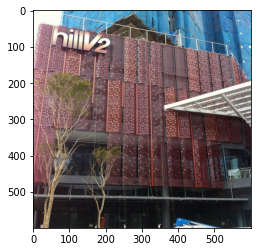

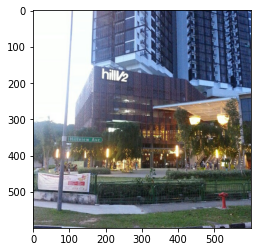

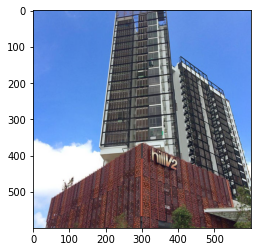

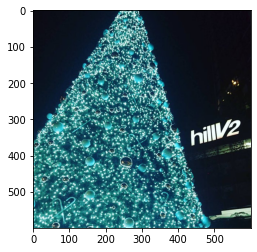

In [ ]:
for ad in hillv2:
  add = BASE + ad + ".jpg"
  im = Image.open(add) 
  imgplot = plt.imshow(im)
  plt.show()

### Dialogue #2710

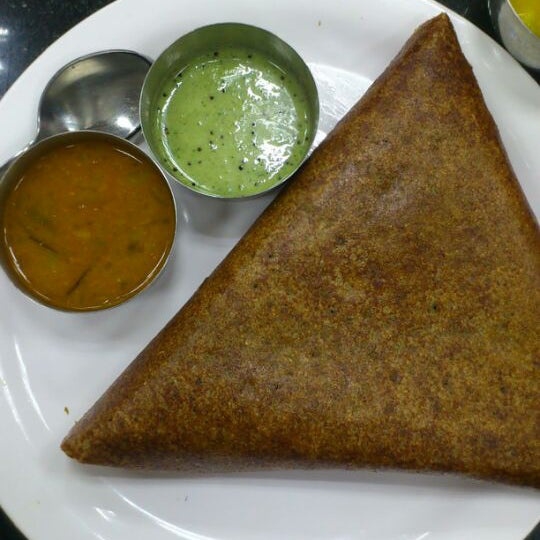

In [ ]:
add = BASE + "d19bed470afc2738ec3cc32992ddbf6b.jpg"
im = Image.open(add) 
im

In [ ]:
imgs_2710 =[
            "1f127c151a51010f8b75e8b78bb7c924",
            "05a7b519b197ff10ab146b0d33afc21e",
            "9fdca7b6bfc5ebbe4b844bb32409d79f",
            "e4b15e247feff13a5f6142cb9203504b",
            "679ebf911695d6877d1dcc2de34a6c33",
            "5315a2c5930d1098cb1c429371c6132a",
            "49aafa134d1862110493c42cf607d793",
            "c12587f2c8ba890435f4c08028e9749f",
            "d7db771722890a64448b0a49e2396af8",
            "2b6b110e10ebf89e2634f469fa2a95a0",
            "d19bed470afc2738ec3cc32992ddbf6b",
            "32fa5c621409b345acfdf4b0a93a2e4d",
            "f709e9d8a926c1f24aad0a987a27cfe5",
            "7ebb0d1e3cb1e859a37b1ef6a7481b28",
            "05a908a9764cee6ae5c84f628dd1f83e",
            "a8a3740022c09c703975fe91f4556f59",
            "45f4c7ffab474dc908775cf479003d1d",
            "e54cb8ff8365a122f0d392abbcd45645",
            "61102fbed3e44b9cafbcb8704b0328b7",
            "e55710732db5e08b322e14ed1e375c4e",
            "b21a4b59f8cf2ea5a0dba3a25b51c5fb",
            "3e0c82656981fc37796b7267f7f49f38",
            "edce0553a76c8944b34d40abec7631c6",
            "64ceaf305ed6f6e33fb5ad6c206aea2a",
            "1f1db97568f4a061e55f08771bddad3c",
            "5bbe2d25ece5196694ac724e96cc767a",
            "3c33f046e967d28cb3d7ab226aa8345c",
            "e42763a14cdbe9506d8a8f30cf7fb09a",
            "fb90732b34ee55609c918c9a729135cf",
            "39a1ad8ddd42915b5eadd047e0922478",
            "c10aaa58b74769955632da8e6feb717b",
            "3218330cfe35a1459705f2fa18076ca8",
            "b5fb4783d961b28f0004c0ea073c0acd",
            "dfbdda81f18d86b3e0b853090652ae8e",
            "4d23dc0485c3da5e4a55879884148429",
            "b3bef937ca25d4c2d804d7174aecb72e",
            "c82dd6e90363a325bb18eb07bff33258",
            "2ae82c87d629dc6d7ba3deee4a7ce614",
            "68e986e50e6813e0371abcef99876424",
            "f5aa68d3f786de484b9c0f3c79a1893b",
            "51bae65b0cefc5c39ff3003a0bd191b1",
            "2385937b5fcdc56ec311a6b209fff0ae",
            "4a2be17772709abc9a323847a96e3220",
            "75a5923d06b8a1c37ab0a79c57cde66d",
            "5257916601029bed385a613382f8a4df",
            "ab2a23de68f62cfc83a784d3b3dd98fc",
            "188d51a1835a04901dfb48809d22c9ec",
            "3a1b3d892132d04c09ecc7cd334b577e",
            "8051f1c333ea73a79fe770f6c2ded52e",
            "755340abe8d45d8df2d2f76edc55f847",
            "d756c1e3054aefc25f2df47f2d1494e5",
            "735141fd46d218cfc249cb5f32e22ed7",
            "887aa753e874652035eb27e9080ec002",
            "91e9c731967cf23a88e22f9174d46450",
            "52e2a2a28827e49b172318b10e196775",
            "0e3df894b1dcf7e7e9cf45e5cbc2b632",
            "7e7af83282bf8df80c05f629e97f938d",
            "928d44ee18d9f9cb3919e69a32d2d692",
            "fb29aece1427893daa638a06a70cd397",
            "0f5ad1dd2aa97f6a6eba4bacefc304c6",
            "f0fdff8ba5716baa04b6561132384f49",
            "aad60d4f30916a8d385bb5a345a3ec55",
            "8c025b0dda20a8d2c03ecb12b989aa52",
            "2bf72ffe7b1d94609af10125a3cfd40f",
            "f673bc7dcdf328db5f739296da7390f1"
        ]

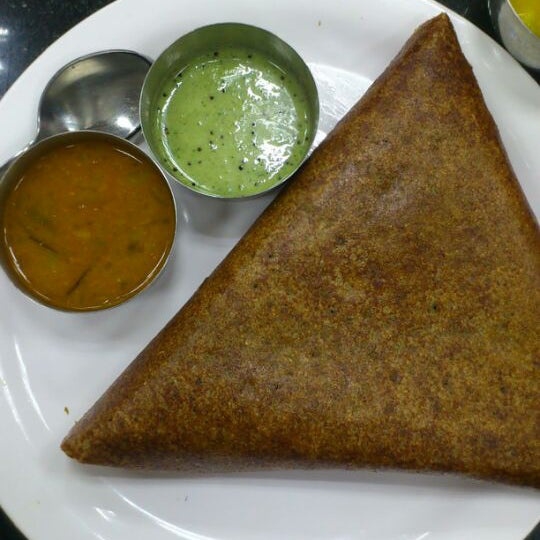

In [ ]:
add = BASE + imgs_2710[10] + ".jpg"
im = Image.open(add) 
im

### Dial 1683

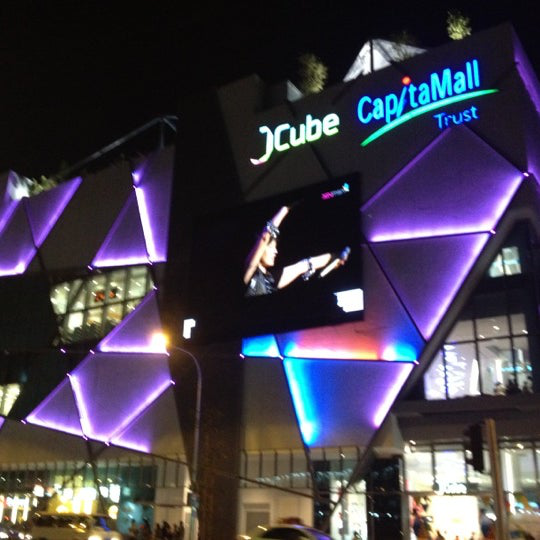

In [ ]:
from PIL import Image
BASE = "/content/Image/"
add = BASE + "8cf474c25904d23bdb32d98c5814534f.jpg"
im = Image.open(add) 
im

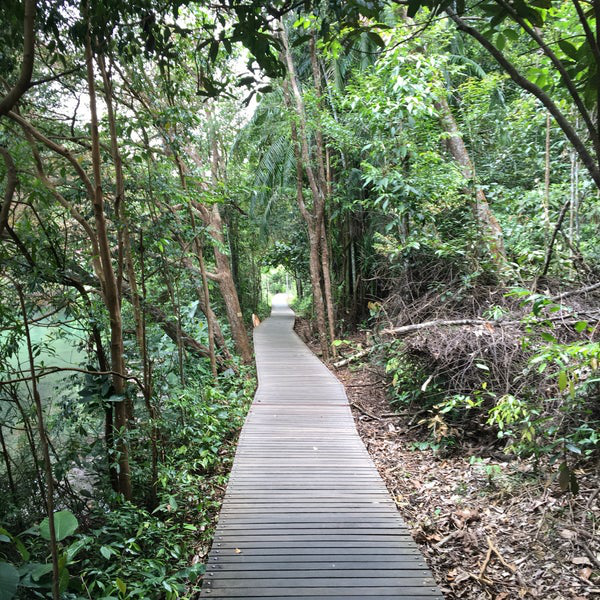

In [ ]:
from PIL import Image
BASE = "/content/Image/"
add = BASE + "4242250853b7501a314e056a37be7435.jpg"
im = Image.open(add) 
im

In [ ]:
imgs_1683_1 = [
    "6507a889829d4d61fd2d7f278e383c52",
    "d8f9d0e6ce07e3f95bab8f402dd98fed",
    "59e2fac006d46eac66d1c22e5b61d9d4",
    "5ba3279651bd0c7e34fb06dfd448ba59",
    "6d76b0d817685289862ad5f27f88681f",
    "6eaf0a8a7f9522653af1d29aa637770a",
    "50d5e9d2757b520ff0c126674ec0f4b8",
    "1e3dea91958aa1888662febf19212abf",
    "02c173ddbefd664ff87d3678eb6058ab",
    "a78c3d28c2d008a1913aa733283601c7",
    "1119d4dca93062e66a2fd4afa397f060",
    "692eb608ccb9a3d14dbb7325d0c72f9a",
    "a9e6ccad30f422f1a7011d2b9b60587a",
    "1fb4b1c3069084ce0bfb05d400ae92d1",
    "2cb6193ef5abd78955f6c35b719d1499",
    "8cf474c25904d23bdb32d98c5814534f",
    "d559d115b10d61c21b3c42cc47752fc0",
    "5401c0277ad7549f0d230e934e8c28e6",
    "3053d182ae86f0c1ca47e16e4d2dcdf0",
    "7c8fea85883d351aecaa06a3653e6d34",
    "e4e9cca2366fe1883b1916524fa416fa",
    "38504b7acaef6826c2d943d52f23838c",
    "7e7e60e7fca9895a55ccd2495a6630c1",
    "979e917f67e2696f287056a22d2009f6",]

In [ ]:
len(imgs_1683_1)

24

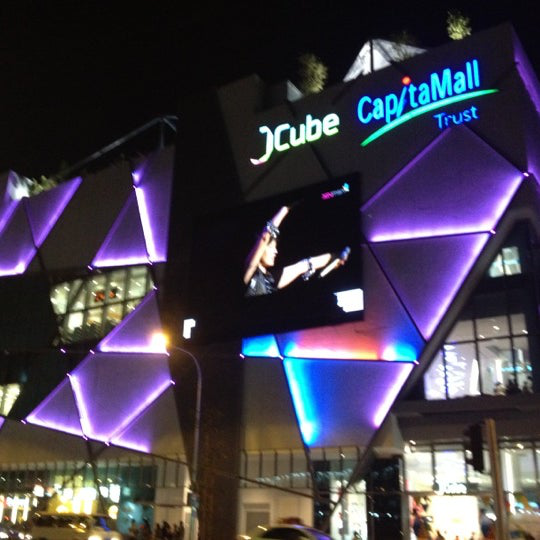

In [ ]:
add = BASE + imgs_1683_1[15] + ".jpg"
im = Image.open(add) 
im

In [ ]:
imgs_1683_2 = [
            "08d9b4467fc3223bd34dcbb32c30bffd",
            "4eedf68e2d05037115b739ed4a8f8cac",
            "f6dc0c17b6d56325ee7c1415ed470286",
            "14e9735675389e0730ab7ecebb54be29",
            "fa24b86547fadbe56100c4b808a155c1",
            "ea8d6b4896d335793d148ec7d66e4a41",
            "aac6acc30c242e94aea1ac526c274fd4",
            "8da4e9d63cb661de8f6b629f39df2a94",
            "370294ef8a6809cda1d9c6f0e4140246",
            "e162625c9e7d2a0dafaaa2cc0209644e",
            "6b8ff848d308a12f237ab5d7448ab84f",
            "0181994ee12a5f1b7d12c46dc18ef616",
            "a190de21e4e9e6b687269c53384878b6",
            "621bc7ffe9936519374a3adbdef94fa7",
            "84738e3d63978473ed10e7235aa02f5f",
            "a56483e16274d71ea3db7beb65ae0528",
            "635712858dd8724d2ed4a402de254bec",
            "1a57e75bd5328302a714dec6087b825a",
            "eb555895cc5482a26e16d01395699427",
            "a833a228e7ea106d203ccaf002dfc5e4",
            "488c3bb126b890d97b0ba3a4915325b4",
            "7976d73ba0892f48f1394c3d76f15ad2",
            "8186c10d0bf8c83638e3d43171b0443d",
            "9e10b6280009f1b4f9ce6729c99bc016",
            "45fdcea0ba48425b74a87aaf7fe8b6b2",
            "83744b43a0ac5c56309325e528e5029e",
            "939b9d212e4fe844491f1f2b08c1b365",
            "8438d96792a3e0aff09ead5b56a34ba2",
            "2b3f067a3bfde447c586f273cd6e6795",
            "750ad248c4966d41ceed0708ed875c63",
            "41a6dfa85cc8f947a7dac30b2307a06a",
            "dd6154ef6179733092cd1aeae11488b4",
            "fef4dc38d837460dc18880d35cdc00d0",
            "c43fad9fd64d7b52c4b79e107670bcfe",
            "c7d6b2f7875da34f127348f7cd2147d8",
            "17fbefb99512534b60bb8146b96d6ecf",
            "38240da1f91fa32dd191f90e73c3a8c1",
            "bf2359af7627849b80b4d6d2583a54bb",
            "43e685081fd3383b063801fd4c328d49",
            "de44baf20b8be64b7d6cad2f2fa15d1b",
            "a0131a542c7c0765fc9c0b53d51a5258",
            "399fbb0da5434838e03c76aee5209630",
            "3ffeeb4d5597169597326f3388c7398b",
            "c7da06add231efe3e5a6b89072f412e2",
            "6fa67920f25a88e3167f6ef7e96317f4",
            "b22473b896d0e6fced6c6a240443c9a3",
            "e9cd6e7516e0e8319225c16518730913",
            "c9b06b31d943a2a75065102918a0b2e3",
            "fbdcaad21d155fb0ed30c62be359e2d6",
            "32547ae1102fb5dd49bef81bffc7387b",
            "3b7ce4a1cfe4c52ef4fde5193d58237e",
            "e466d03f2f9e980971ecbb8d60610e86",
            "b74848ee805374c055a7d9ae3fcc650e",
            "fb9b51d5a12e53b89e8929078b883a90",
            "14db4e0c16c4a84043c435ef1e3d6f93",
            "e131963a4e22e126507e0b30d0edf492",
            "3f53d024e2605703ea6fc9f38122d8ca",
            "7922351bef4de2166e3472b36fa1b243",
            "4a40e7791f95ccb48b6310495ab9eb6f",
            "a04e1c862a09d9d54f53df819a1397a9",
            "4b47db55bc4ccabcae58f5aabc49e518",
            "1b1dc8246eea2e90b3dd24852a21716a",
            "46081960ac0c275c64c1a21ba83df0b1",
            "48281a1c16647fc819a0f370061eed54",
            "2c644a0bcf8b32cee2d6d3014ad77a3d",
            "cf7b155c820919467f5e91af0e92e94e",
            "80c46e8d7b4921e7380314bbc7ba8ec5",
            "2d6f597cc7235741ded4d2ab28016298",
            "3656a16f85407974831ddfeef58bb5df",
            "75a3d0b2d43760e504193ebd7ae4d614",
            "5a7f212fe27751088b54addaedecbd55",
            "e181414277b62403f3b1d003c30bcf7f",
            "8a6ac3c1ac89f73957a022dec23c4dc0",
            "a8fcc23cdc58a743311ebf2eb83f3f4e",
            "1fa2d892cfd97b78f31e1b17f29f23bf",
            "442d64cfe2b91b118c689b3bfa7806f9",
            "152b4f9be9635afb409fb6421a021485",
            "c25c0bc54c292a3a91e175361ea5dee2",
            "1ed6b549e0a053251c3b69d2c558e2c2",
            "002afcc44b1ebc8bc782d24a3578b164",
            "9d81ddb558075dc89b0f806f8ecc8f5a",
            "f42f9c46e5d85a2969356e3532a19373",
            "1df2c1dbd0808e614b8f7b88f5a7785b",
            "9b5575e3b06604cf48cab1d3768851a1",
            "533bac4d8a79a127f12d2375ead71834",
            "1a4e17038070523307f87c47c5d19088",
            "76644b52b193973ea7b9654a25aded90",
            "715403c61558da80bf718bd64ed46164",
            "758141bfa498e6953d6e97ab91509257",
            "7b6980c72b28a2f352d9e9e35e146125",
            "5fa23bcd6ae7bfaae3f83d7fa48f056f",
            "2c6b25c64d2f652eeeab217fc9ee4d5f",
            "d490f07b6411d7c3b1cb585ed20321e8",
            "6678e0a987b1dd16ae0ed5fde1505a31",
            "0d1ed910fec9f13deeaed54278241a21",
            "0c32a6232130b3ae51d6cc856852b41a",
            "7d49b030a8977183f8504ec1eaeaaf72",
            "e907dad5551ef84fe6293d5091fe4c16",
            "cd0350443134188822cfec3789431a15",
            "d0b72ce7e1eb2a033664a78316a678b8",
            "e797dd71c0bb6e3b3cf412416582f08b",
            "57cdd827eca608843ff68acbefa640dd",
            "90fdf4601f716a12ef9001be82531896",
            "d9f8870385ebbe19b6fb439d50283f5d",
            "c80cc67fb45c8d267995492dd78515a0",
            "2dd74859cb87a290069629c1e7a395cb",
            "3c0a729af050f4e698bca813ea2e908c",
            "b86ba1635ecd8b0a972cb2fcf4e593d6",
            "7040da2325f9241b89d99ac5526b4130",
            "f956d248d03eb96c78c0790c457ca99c",
            "4cdfe0a0d52ee51cae5e56db00922863",
            "52bee38095a7bb5658e3bfb760c389de",
            "7be931763b01796bc7db6c1401949a59",
            "12b4f9116ff573ca91f7c3a41b788a08",
            "4c84c3371164593b345fb695446e6271",
            "06911311763d21f27110c92ac5c5a3f6",
            "d39c627c9507f454b873a2cf49aaeeff",
            "85bd929cf5daaea5795ad04134ce7611",
            "9b5045d307758721cc81e568380aaff8",
            "5e653fa74151527256c29492a6ff350c",
            "6fc0de43665e8c3d3d5bc96472ccd6d9",
            "a0c6a2ac65320a59fb3fe118a03f1e31",
            "38e690da20b7ca672e680ae582137486",
            "d39aaf8b66c451a7a819be8f038a14ea",
            "576508acbce011a257fb3b1d3bcdfaf4",
            "accd19dff57e04b4ef25bffee1ebb069",
            "991e31d7d9485fa601e21e839e5d2b95",
            "7a835e1ec8939749069e325982ef0293",
            "1caa072ebac00a95e2a8387fb74045ef",
            "4242250853b7501a314e056a37be7435",
            "7514854770974c991d3bcc656b290fb6",
            "e93b96bca69b02c38bfa8903b35ba64c",
            "bba771e13b855d974d2a8ca0f6ed14b9",
            "56ea8f444778ed6c7a1ae51a7cd8896b",
            "65f23395837a94051821359fe6258f76",
            "e4cfc54c6ea6ed19d2f4548128d33e5e",
            "b98ac867808624cc29fbbf05b2c7bd45",
            "d0590e853263a84ac9ce5074fe1c9df3",
            "73581871582847905e581579ea8e481d",
            "e60a66e6a6179aefd9b78a0bc660976d",
            "faaa0064944905a22046590d3f2ded9a",
            "600c4fa8ab6100a767b3a393381aafa9",
            "599d07e0efe1fc6e6f26f0e04b554832",
            "4139d4b9055915bdeadd4e7d6a956965",
            "03cde5877f6893a60a4e52ce6155cbac",
            "9b76468790482bd573bf7850ff76efec",
            "e4dcea3de3641835fa31f4c4809101a7",
            "19be571569effe8a0e955bd933853a07",
            "722982e59a2bfd15b8b15321fab7e0a4",
            "16d2c0d151c57495d48b601149624383",
            "d64687113512d16f11d5db46551eec3e",
            "78841b95d43db58f29f03860fca7a4ce",
            "938897e0f4333266b286fd0bd716f6ea",
            "acabb650d6130629ed634f16741ddd35",
            "42547d6ab54848d693137f5f7c9f1957",
            "e13f97e1d91e74a0ff053435df194af3",
            "3caa03a3c85fc07f7425c42fef2cdd11",
            "f73756282f29403f263cceaeeba1f2c7",
            "203005739a792a6b2cd7cfaea3c01bcb",
            "55bb7e32a0e062252f16fdb3be312479",
            "8df2818f6f5908e2b32f0b45b8c28746",
            "f9906510449fdfe9469fd6a1f88ddd47",
            "bb1f01dc4d4e3bb562475db19e3b4fd2",
            "a6eda4e67bb0a51a2fb73b7e2d4278d7",
            "68f23eab252ac10605fbe15de5a3ef9e",
            "9b2eeabe79f9d7d01437ccebe858bc29",
            "8913361b083b88b92651e95a15be4754",
            "e16a75dca577b0bc082059ac67892287",
            "52d81f51024586017e92822ff3f2fb06",
            "efeb43b1cd768d6e7c320a68d20e98ba",
            "7d2ab287b9ce73442fdd81619353ac3f",
            "ad6749c16ed1b04ef8430bed5b31b9d9",
            "4820196218955121b35c5f894bf7fadb",
            "a7cdebf0dff0d15891a1369c8b6c23b7",
            "4fac56f86947973bbbe935442004caaf",
            "754c33d19c76289c9769747a07880070",
            "ed63f90c3b027a5cc6e2949ef5fe75bd",
            "144d8ac91eeafe2ba05bd36d59cb9edb",
        ]

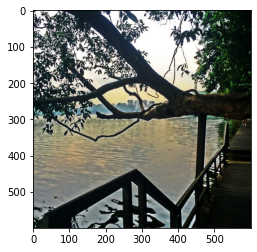

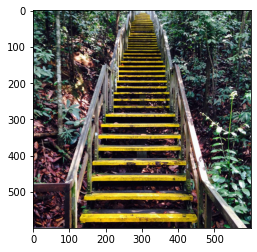

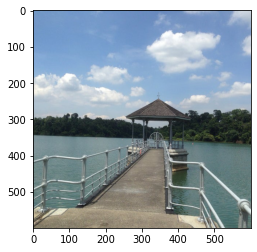

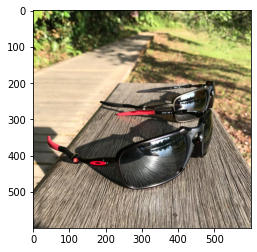

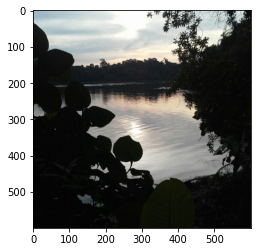

...

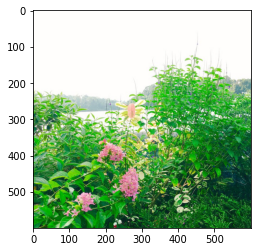

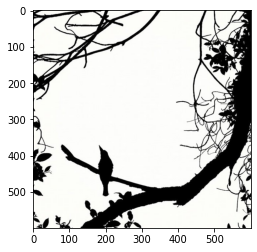

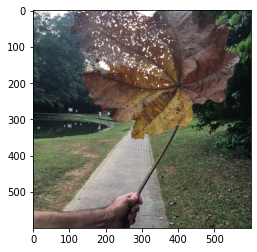

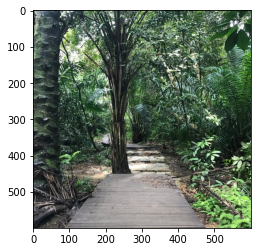

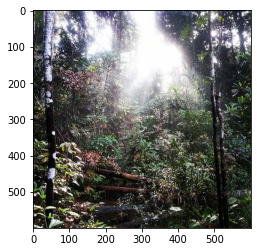

In [ ]:
i = 0 
%pylab inline
import matplotlib.pyplot as plt
# import matplotlib.image as mpimg
# img = mpimg.imread('your_image.png')
# imgplot = plt.imshow(img)
# plt.show()
import time
for ad in imgs_1683_2:
  i +=1
  add = BASE + ad + ".jpg"
  im = Image.open(add) 
  # print(i)
  time.sleep(1)
  imgplot = plt.imshow(im)
  plt.show()

### Dial 434

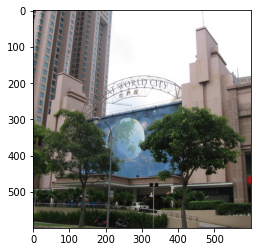

In [ ]:
# "18eec61131813d3cf47d4d0e7776fa44.jpg"
add = BASE + "4aca93be9bc19ae98d9dd0082f3df462.jpg"
im = Image.open(add) 
imgplot = plt.imshow(im)
plt.show()

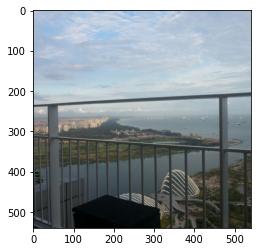

In [ ]:
# f8584cb6cccfe121ac9f75383f878188.jpg

add = BASE + "f8584cb6cccfe121ac9f75383f878188.jpg"
im = Image.open(add) 
imgplot = plt.imshow(im)
plt.show()

In [ ]:

add = BASE + "f8584cb6cccfe121ac9f75383f878188.jpg"
im = Image.open(add) 
imgplot = plt.imshow(im)
plt.show()

NameError: ignored

In [ ]:
imgs_434_2=[
    "86c4e426de1f6ac36cd44b97eb32a9cd",
    "b4e40107f92a0b416a50d3b03ab41a60",
    "a4c453d284b653ae80e9685b04dca833",
    "0bd412f04f46440bb5073289a98c2f9f",
    "bd20a4842dfab24ba1a60cd06953a631",
    "53f112c2165c47de591358ad9e4ee8a3",
    "5eb7f2f9142ea7f9951a79336546e39e",
    "34d5a05d7785b85b5699ca526982dc62",
    "4bcca559a24971683fd6a6c8333bf75a",
    "3c488cab2d751fec946c3bb3bc0a84f4",
    "36b5551a3600bc5de80e68ccded30f0e",
    "9fbbfaafd3b4e62b7a3a03555fd586d5",
    "2e4c74c91aaf2a5b3329f71a76c61758",
    "983f43e0c8197a05066c2bdb2332519f",
    "f1377c8490d44f7c8a8ad874291630b1",
    "6b6b69678fb31b9e61d0634c6eff4b3a",
    "bf665a9da98f52210046834fb1a79aab",
    "d591127d6558040456567472500d3936",
    "9467f562456462996d323f1b87c928a0",
    "f3df07aa01a5d88ee4ed5b906fd569a7",
    "394d3c97021b5479800153d009a42cb9",
    "ed025c14028b946e1f60a0b2f98886b4",
    "2eaa392dc8c470633aa64fce0ec9102a",
    "7f3fb4e1e851b3dc7a725d26a8583eca",
    "bb8595f77065e1b84e3c5bc4d0eea8c8",
    "5051121faca2e49ea1ad3dab8edcf43e",
    "c954ca926e805078abc7961b9c9a25af",
    "506d5ee1883b4f6b2d774f9ee9e1d6fe",
    "dc096447e07a485b2703139e78ef0003",
    "16cffb8d428e97a1c79e5400665327a1",
    "0ac790a3b0266418d622837a48512952",
    "c0d23aa7e401c44353a99cf84e006d9c",
    "8cf76dc78a44932a5034c8dcc58c9475",
    "18b7f17db88d2afde0acb693867cd0a5",
    "0a871298711a1a3c93927fc7bd1367ae",
    "6b77260ecc5a517d5f39e2072510d086",
    "10465c9043db30ec6ec1c55fe99eaa6e",
    "6eb52ca5d8e1ba3d70112e732cd981c6",
    "b0cad3652e654fe4ff1c4c46729f4685",
    "1f68c8f9ad90d2afc44022dadf57e9df",
    "c7133a0db91c547e0237fe41fef67dab",
    "3061b1f729f1460517eff1a0763e093e",
    "fe6d4c33e641405f175b8711670f3c66"
]

In [ ]:
imgs_434_2_2= [
      "60fc06a26a6d0016e1880ea188796d92",
      "da2f155e9c321c32e613939da40685b2",
      "c76f4b1cc719b7dfcdc23d0020c31833",
      "7a1191d498a3a00790319284bc86242c",
      "9c3c0f77c5d5df9637d98bcc366078ef",
      "f3728fff47683e4ab12f2183ba461ff0",
      "0e88c01c87e487b5b58d1d3ebbcec31c",
      "a320ec3b3a29230b72a54e478fbbe0ea",
      "9bdef2ab7bafc944f4069e2b1cf3335b",
      "f2caf785a25da13ba742f770562df75a",
      "1957e67b20bee3d4f29ec2e3dd87b04e",
      "51585546b6c076532575ae8792a369cf",
      "a1fa84f7b1b994ce3a92585de51558b1",
      "71132101f87c0298500706ad3bc2170f",
      "9ab87ab00054674b204a38ac6d004f82",
      "8980ab2061a651a28c22199b620a57a0",
      "6523829707db375bac2576c3a9354cca",
      "68a7a73fe40da76f21430963302ca99e",
      "3b501747ba3c81af7725cf0a0260a6ac",
      "0f3947486f5a91adb98cd5c9de94df39",
      "835973cd22a01d290826fbb1250fd3f6",
      "520f92c21088392f25a501b878df0564",
      "6b1df1aae21ae7836ed99270141afe3c",
      "813cf85b6e388321879359f7fb2b644d",
      "aa2524d085647bc6d3f369c5c098e5aa",
      "7329a82334f12c409b5c768bf96383ab",
      "7438f887a2e290b36a8ba5613dce65ee",
      "774ef75378d4fc9ab7f6c681f19beff1",
      "6a0cd48c2f17e80edf914ec90e5ca1d2",
      "fce9db183163ab86aec91d5fe8a602ea",
      "ea7e695bcb383654902536855c3c67b0",
      "d94dcd67b76eedbd08ce5291da71789d",
      "87ea147c630faa2c903fbbd378c634dd",
      "908b45213411b14ffd7e68f9fc576e4c",
      "63e5ca8708b582480a24b6547b51344d",
      "37fa8e4fec1f8bde10aa541c549e07f2",
      "cfe22f8c2d003fab2543efeef623786a",
      "c7e609a13e0dfd50e8d797f87d0a7753",
      "51e94867f1d71c0877c10727d146aa08",
      "63cde5f0d1380c579c5a4d1c1afb9efa",
      "9b35033b6f5facc6d30f8b1261d7e49e",
      "27105702c10e04d34e0d6d349991432d",
      "95a1a0416c2a2ef4f26024c6ae8dae03",
      "4b5ed56411ea6b14def0d1f1965dce28",
      "5efb4439f2ce75ccf441744ff863143d",
      "d092ae67fc0da6b27267ba9bb0135fd1",
      "74bc62df87214d66261c9e71a876fce2",
      "302f69d6169b138778c02c650c0f41c0",
      "9a5334d7c70a6146cbd94dea040254d2",
      "2132598a57a76a80fd7ed75c51c072cb",
      "451f2e8270f80eeca4c4c59cd371e6a6",
      "439a14f9ce59d567cba8ac165753727b",
      "b6d3bc23f0f5dffe91464ca8c9c3da78",
      "d089fec3a358f8652786d099897a1182",
      "4745d0bafa378bdcdd5a551df3fc1e75",
      "494c19b46e0fdc84cdf077bd8b95771a",
      "cc61700ea42240acbcfe1ced2eb360c5",
      "fd73caa0721a156d479f845973f2886d",
      "e665be9ef7fe5123769d1d5ee20e3dea",
      "555f404ad753c65a210452361b23c904",
      "1bd3e88d49c586d508772723ddb3bffa",
      "f4dbd88d5fad025ba14c1e8c0d37b160",
      "6f7106070ce88a4542af09d790bf3a31",
      "cfcfb4c880b53af8bb06cadd4c4fb1ab",
      "0aeac51ac5246d5c0edefa6176979921",
      "166ece0468472b12b4a656f66a7ee94f",
      "675139ebf56563c96802eeb9ac55b6d2",
      "622e16b86b95e942b304aa9bc249edb8",
      "3747de809c633517cd692d202c858be5",
      "c474738cfc1033f4496e4489f17fedd6",
      "bf6b0bd0f7377fa9ae0a5e1c15a7fe84",
      "6a712450cf6a6cf29657fa1f0042ed76",
      "0582880748238d5b539535ce61d8cddd",
      "1d8f0a87bedb0d913b0a64563184a1e6",
      "1ab964dbba9b340ecfa526c52d764ad7",
      "63618f6d2bfc17a89145a92e7f460776",
      "6bcb5193c594b70e14e576d4439bba16",
      "83b15369ac73973fba51a8032b93326c",
      "49cdcaafaf43bf1e99103195dc622688",
      "a4fc795118ca31d690705824903c3867",
      "c45c1e7c601c8da3a0e4daa89c235663",
      "fa06eea895061ec137b19c3df14a5981",
      "b18a46b5350e09de15c0e1560f1f87a8",
      "5556f16e35cad8fd5d0d39c9157effef",
      "e0a758d4fde1e0a1be62ead74a926adf",
      "fbeee01ea3bafa039015784d746a9e88",
      "564b2067de533e97660e1c8bf8f87588",
      "46428323fc0962c140e630319f2fa644",
      "994111693df7eca974d6b7848eb1e44d",
      "874be7d380079355bca452bb3cef79b4",
      "63d93e39aa839e50aa7ca707e14ccd44",
      "8fa491d67d8bd4512917d4e5887c7a7f",
      "e6ac9e793ab964a5c0fcea701c06773c",
      "4e6721b1b7d2d7ef932388be1bad6905",
      "63ffb5d508bf1d5f93d3d1a010c5a2c8",
      "9ace59283f12322bdd18b2ab2a4d7cfc",
      "8c9fed456bf993c9e53c4af262f6e43b",
      "d64705a17529860b6efef9439b842bbe",
      "2e9f37e523fd0bdd5677f08bfee5b6c6",
      "27ba2cd28bef46d98d2ae62915350dc0",
      "8a18d99fe8623a40fe8728e0aeb23750",
      "0fc42f6b41b73c2256aacc592d85f07c",
      "a118039fd3526bf63beb1f49ece347ae",
      "5e89ada9df7b41618844bde32445bbdc",
      "41263c57076162e36648258c714aa559",
      "a957db67951158af6f2f6a79a265a543",
      "96b262081fe28a066714193ca85e9a6e",
      "02ddb705f9f450324bce39bc8b86c811",
      "5ea9cd5d9f355da8cdd28c11ec191f75",
      "05a571198a574083d2ca617b80d1be89",
      "85623bec02f394938450fc0d2b894173",
      "8aec3b2555c6213e1d7a04b2e2afdc75",
      "f01ba2222e0d3f01228390add79f4b0c",
      "cbc5cf681d51fec1c32e2fb34f2059ed",
      "bb15f3373675c135667e75b7eb596f97",
      "3bdb3ff0213a7660998d7811682123ec",
      "e9bad33b4bfb88c72f3f361e74251658",
      "e706d2927e72ce3adedb5383a2bb83b0",
      "319558d1861a07d1d6ff192828c506c3",
      "b75f73b1c784aee04a74ddd80090d9b7",
      "3e69ac02480094e7398a205a97526d56",
      "45a5ed9e8dcbc16815559c93fba3fd52",
  ]

In [ ]:
imgs_434_2_3= [
               "fccfc8e03725d64e7a3d9552e9e42c72",
            "7eb1dfee1be4e28eebbe1141f16cca94",
            "cbcedac2e09ebd94da1752ed7aaab785",
            "8a8942bfec18ae8de12bb957d1f980c4",
            "a56103d9394da12c47b281cc9fd137cc",
            "5070fcdc86595120f77f699bcecd83ec",
            "b6ad8f844365d20df4590d60a714b8c1",
            "386aa33ab15b504a676120ba58020291",
            "b57279b1f5d5ef8ebdc65e70026a831b",
            "58181c84740bc458db1dc59c041efc92",
            "222bdc6d063b0ca8d9f85dd39ebf647a",
            "386aa33ab15b504a676120ba58020291",
            "1dba87843740b2efba812fd0f7fe7906",
            "bdc23b81e5cac6762a3580045613dbc6",
            "0f82bb2ecc2e866859ecda66e0120d06",
            "2b38557f9bf8107aadebf3213ec2a829",
            "669425bbc2e7e9a2af83b6ced5cab670",
            "fedaf7e7fbdc05ff4139a2bb9954d66c",
            "7465b7b1084e295abe38b266f6e6ab99",
            "7465b7b1084e295abe38b266f6e6ab99",
            "d24dc0c23aff395d3bac19eb6ba5c154",
            "f205d5a3b66776370b9116476457d7a1",
            "58ae2e9c13fd3795ac3ee08cb1c0e801",
            "28a59c9a249359d3314e90114f460381",
            "6669a80f4b3d7d7d169b7be4aa2029e2",
            "2a793933937ad70f1ee1cf03af52e39b",
            "e696a19006ae93f571e3e275f4617954",
            "8d3d496796231cebb1d619966c79eee5",
            "c1a13e68a835d6251734f13e8801ab1a",
            "f8f2c8a766bffe9d658f2c38cb94bbd8",
            "b97ed30cadb508e05608d7d7ea39fc11",
            "7a84f765cdbc8d036d71707a0b5cbd1b",
            "19eab959b1c52b4477981a146a78bbf0",
            "e52941c086c9c6ee31653686546a875c",
            "66c1beeba7fcb271f2e82c1f13789a38",
            "e1842916a9fc6133d1efa9b622021d25",
            "b7d3c1bcd74bc00e4625c5566427d6da",
            "0e417382b321c24582da6f17ee398b19",
            "e856e6193338897be10f5ee362c672fa",
            "2738369ae5850f8a7b411978ed5c2412",
            "7743af85692a372ed9511d19a9f9bd98",
            "e856e6193338897be10f5ee362c672fa",
            "50252ee4bce2822fbec2c6886757ee63"
        ]

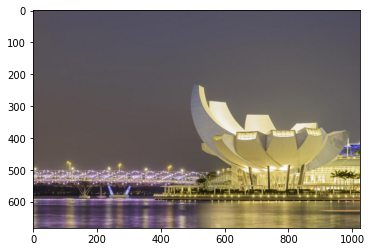

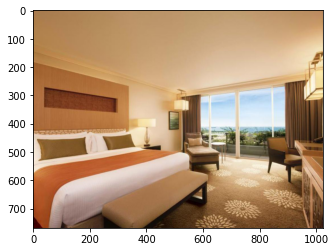

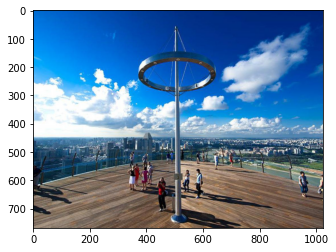

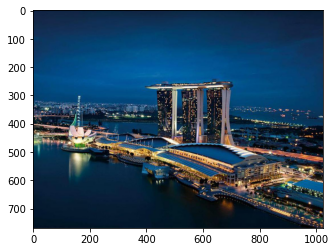

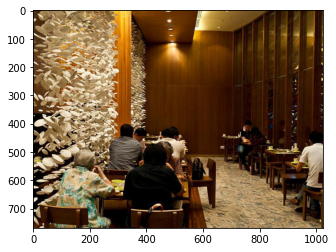

...

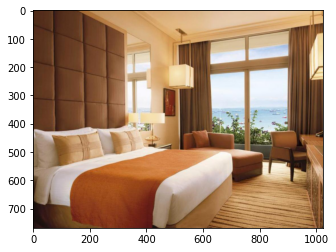

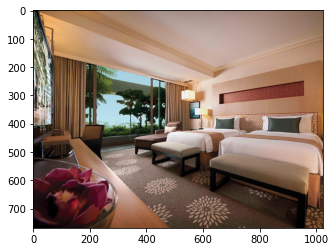

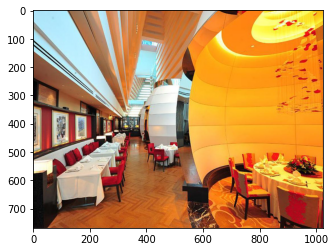

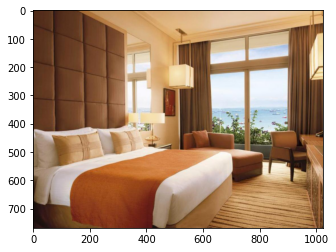

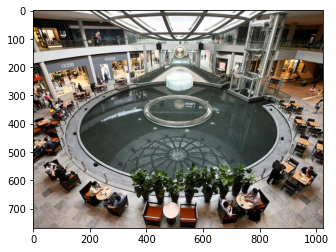

In [ ]:
for ad in imgs_434_2_3:
  i +=1
  add = BASE + ad + ".jpg"
  im = Image.open(add) 
  imgplot = plt.imshow(im)
  plt.show()

### Dial 6476

### Dial 3778

### Dial 622

# Using Image_id as a priamry Key 
(images_id from images.tar.zip)
'image_id': {'class' : 'c', domain: [d1,...,dn], venueName: [v1,...,vn] } 

In [ ]:
# https://drive.google.com/file/d/1-4Of03ZTx1bZq6SsTbfyIeHet0Efw9ni/view?usp=sharing
!gdown 1-4Of03ZTx1bZq6SsTbfyIeHet0Efw9ni

Downloading...
From: https://drive.google.com/uc?id=1-4Of03ZTx1bZq6SsTbfyIeHet0Efw9ni
To: /content/photo_ids.csv
100% 3.75M/3.75M [00:00<00:00, 194MB/s]


In [ ]:
%cp '/content/MMConv/dialogue state tracking/image_classes.json' /content/
%cp /content/MMConv/dataset/db.json /content/
%cp /content/MMConv/dataset/dialogues.json /content/

In [ ]:
import pandas as pd 
df = pd.read_csv('photo_ids.csv')

In [ ]:
imgs_attributes = {}
for key in df['photo_id'].tolist():
  imgs_attributes[key] = {'class':'',
                          'domains':[],
                          'venueNames':[]}


In [ ]:
with open('image_classes.json') as f:
    img_classes_file = json.load(f)
type(img_classes_file)
# Output: dict

classes = list(img_classes_file.keys())

# print(classes[:5])
# ['claypot', 'bar interior', 'beancurd/pudding', 'animal shows', 'ramen']

In [ ]:
for i in range(len(classes)):
  if classes[i] == 'Fried Kway Teow Mee':
    print(i)
    classes[i] = 'fried kway teow mee'

In [ ]:
sizes = []
for key in img_classes_file:
  if len(img_classes_file[key]) ==4 :
    print(key,img_classes_file[key])

  sizes.append(len(img_classes_file[key]))

sizes.sort()

trick eye museum ['b473f16186120cf66b6f458c5506b423.jpg', '2cd0ff1bb7ddc24ae09804b612651eeb.jpg', '6d7c1f481f6b8ecbdd131bc44662e79f.jpg', '774061601daa9c3e1716267537f172b8.jpg']


In [ ]:
len(sizes)

315

In [ ]:
for key in img_classes_file:
  k = key
  if key == 'Fried Kway Teow Mee':
    k = 'fried kway teow mee'
  for img in img_classes_file[key]:
    id = img[0:-4]
    if imgs_attributes.get(id, False):
      imgs_attributes[id]['class'] = k

In [ ]:
 with open('db.json') as f:
    db = json.load(f)
# print(type(db))
# <class 'list'>
# print(type(db[0]))
# <class 'dict'>

In [ ]:
db[0]

{'Credit Cards': '',
 'Dining Options': '',
 'Drinks': '',
 'Menus': '',
 'Music': '',
 'Outdoor Seating': '',
 'Parking': '',
 'Reservations': '',
 'Restroom': '',
 'Smoking': '',
 'Wheelchair Accessible': '',
 'Wi-Fi': '',
 'desc': '',
 'domain': 'sightseeing',
 'imgs': ['35b5a7f4e3677ecdd9011f6acd689f22',
  'd41b7e6f1311bf11c38a22e285a45108',
  '99513bfe9e2d4d20f5a379910c8b40fa',
  'ff790f2689171d999a60bc6a36539395',
  'da7b75337201cbb1a6b84c9adf40a939',
  '84eb0a1e6c7beb2efee162712a301908',
  '8b0b398e8205f6ed1d36cedbdc2ae75c',
  'd26ebd32801993cde2c3991fa7efbfda',
  '6e4a04996a0556d34cb5947c7e04d2fd',
  '1ce1ef05ab9f48ecbdc4bc8d56b476f5',
  '486422ae9cd83d4e0fc79aba5d309f86',
  '5cf7fa60b566876d1fa1e5198fe3e0d6',
  '19b3770cb7b89476b965ec2407fb0ade',
  '4e3b90579c511aaa7411a591a67cf893',
  'c2335e5c998ef5634b5be8118415d831',
  '7d18167839fd54f227f4ff48028db683',
  '196662e913940f962e1073f66498becb',
  '727d37b3322ef4992533f4672ac19b70',
  '6dc6e84ff049581a8f4247532fb4f478',
  '93c

In [ ]:
for dictt in db:
  venueName = dictt['venueName']
  domain = dictt['domain']
  for img in dictt['imgs']:
    if imgs_attributes.get(img, False):
      imgs_attributes[img]['venueNames'].append(venueName)
      imgs_attributes[img]['domains'].append(domain)
    else:
      print(f'{img} does not exist in imgs_attributes dictionary')



In [ ]:
# imgs_attributes


# {'b08d81438110c25ee08b5a3015c0e1fb': {'class': 'food stall',
#   'domains': ['food'],
#   'venueNames': ['Circuit Road Hawker Centre']},
#  '1bfcdd0b669872e05dd58a6f9b4b0a2b': {'class': 'name board, building front',
#   'domains': ['sightseeing'],
#   'venueNames': ['National Orchid Garden']},
#  'daba1bed550f74d6eed4b2675982acd5': {'class': 'beer',
#   'domains': ['nightlife'],
#   'venueNames': ['TAP Craft Beer Bar (One Raffles Link)']},
#  '8b57bb22e36296c2c050df953db26f84': {'class': '',
#   'domains': ['sightseeing'],
#   'venueNames': ['Istana Park']},
#  'c21995ae18a5acbd3ba15e207023ac7e': {'class': 'frog porridge',
#   'domains': ['food'],
#   'venueNames': ['Eminent Frog Porridge']},
#  '6e22d2c6c2f88e4346e065c95f0c8637': {'class': 'flower',
#   'domains': ['sightseeing'],
#   'venueNames': ['Tampines Eco Green']},
#  '28f70b9d50f94b07e4fa9647ce8cf912': {'class': 'forest',
#   'domains': ['sightseeing'],
#   'venueNames': ['Mount Faber Lookout']},
#  '293b7575d626c852b9c1c0c97221fa2f': {'class': 'esplanade concert/theater',
#   'domains': ['sightseeing'],

In [ ]:
imgs_attributes['e10d798ec8aacc165ef6bc4d107aa6d4']

{'class': 'Fried Kway Teow Mee',
 'domains': ['food', 'food'],
 'venueNames': ['Shunfu Mart', 'Shunfu Mart']}

##  EDA for Dialogues   ###

In [ ]:
with open('dialogues.json') as f:
    dial = json.load(f)
print(type(dial))
# Output: dict

print(list(dial.keys())[:5])

<class 'dict'>
['105', '108', '109', '110', '112']


In [ ]:
# imgs_attributes
for dial_id in dial.keys():
  for i in dial[dial_id]['dialogue']:
    for imgs in i['agent']['imgs']:
      if not imgs_attributes.get(imgs[0:-4],0):
        print(dial_id,imgs)
    for imgs in i['user']['imgs']:
      if not imgs_attributes.get(imgs[0:-4],0):
        print(dial_id,imgs)

# Corrolary: All images used in dialogue.json file exists in images.tar.zip

In [ ]:
classes_dict = {}
for label in classes:
  classes_dict[label] = 1

agent_unk_gts = []
user_unk_gts = []

# imgs_attributes
# note: this code has a tiny bug when dilogue.json has different labels than image_classes
# but does the job that is primarily desigend for, whether dialogue.json has no label more than image_classes.json file or not

for dial_id in dial.keys():
  for i in dial[dial_id]['dialogue']:
    for img_gts in i['agent']['img_gts']:
      if not classes_dict.get(img_gts,0):
        print('agent',dial_id,img_gts)
        for img in i['agent']['imgs']:
          agent_unk_gts.append(img)
    for img_gts in i['user']['img_gts']:
      if not classes_dict.get(img_gts,0):
        print('user',dial_id,img_gts)
        for img in i['user']['imgs']:
          user_unk_gts.append(img)
# Corrolary: All images used in dialogue.json has no label more than image_classes.json file

In [ ]:
for dial_id in dial.keys(): 
  for turn in dial[dial_id]['dialogue']:
    if (len(turn['agent']['img_gts']) != 0) and (len(turn['agent']['img_gts']) != len(turn['agent']['imgs']) ):
      print('agent',dial_id)

  for turn in dial[dial_id]['dialogue']:
    if (len(turn['user']['img_gts']) != 0) and (len(turn['user']['img_gts']) != len(turn['user']['imgs']) ):
      print('user',dial_id)

# Corrolary: All images used in dialogue.json has correspoding label when
# when img_gts is not empty. Its emptiness means that the set goal of that 
# dialogue is not to find out the 'concept' (or 'label' or 'class') of
# that image. 


In [ ]:
# imgs_attributes
for dial_id in dial.keys():
  turn_id = -1
  for t in dial[dial_id]['dialogue']:
    turn_id +=1
    i = -1
    if len(t['agent']['img_gts']) == 0:
      pass    
    else:
      for imgs in t['agent']['imgs']:
        i+=1
        if imgs_attributes[imgs[0:-4]]['class'] != t['agent']['img_gts'][i] :
          print(dial_id,imgs,turn_id)
          print( imgs_attributes[imgs[0:-4]]['class'] ,'\t', t['agent']['img_gts'][i])
          print('a\n')
    i = -1
    if len(t['user']['img_gts']) == 0:
      pass    
    else:
      for imgs in t['user']['imgs']:
        i+=1
        if imgs_attributes[imgs[0:-4]]['class'] != t['user']['img_gts'][i] :
          print(dial_id,imgs,turn_id)
          print( imgs_attributes[imgs[0:-4]]['class'] ,'\t', t['agent']['img_gts'][i])
          print('u\n')

# Corrolary: there are few labeling conflict between dialouge.jsoin/img_gts and image_classes.json
# in case of dialogue#5447 / turn_id#4 the correct label is sashimi, what is written in dialuge.json file
# in case of dialogue#5447 / turn_id#6 both 'hall' and 'building interior' are equally correct!
# but we change these both conflicting cases to match images_classes labels by the following block of code --->

5447 0d73fc9ae1eb1c07f44e4a0aab865665.jpg 4
sushi 	 sashimi
a

5447 09500fc2852e2138c37c785ec965debf.jpg 6
hall 	 building interior
a



In [ ]:
# change labels conflicts by this block of code --->


# I decided to leave those 2 exceptions alone :) 
# Since It is not a priority to fix them.
# So, Let's jump into evaluation part.

In [ ]:
import pickle 


with open('imgs_attributes.pickle', 'wb') as handle:
    pickle.dump(imgs_attributes, handle, protocol=pickle.HIGHEST_PROTOCOL)

# with open('filename.pickle', 'rb') as handle:
#     b = pickle.load(handle)

In [ ]:
%cp '/content/imgs_attributes.pickle' '/content/drive/MyDrive/paper/'

In [ ]:
%cp '/content/dialogues.json' '/content/drive/MyDrive/paper/'
%cp '/content/db.json' '/content/drive/MyDrive/paper/'

In [ ]:
##                EXchange image without gt (ground truth)                  ##

agent_without_gt = []
user_without_gt = []

for dial_id in dial.keys():
  turn_id = -1
  for t in dial[dial_id]['dialogue']:
    turn_id +=1 
    i = -1
    if len(t['agent']['img_gts']) != len(t['agent']['imgs']) :
      agent_without_gt.append( (dial_id, turn_id) )
    if len(t['user']['img_gts']) != len(t['user']['imgs']) :
      user_without_gt.append( (dial_id, turn_id) )    


print(agent_without_gt[:5])
user_without_gt[:5]

# []
# []

# C

[]


[]

In [ ]:
dial['162']['dialogue']

[{'agent': {'dialog_act': {}, 'img_gts': [], 'imgs': [], 'transcript': ''},
  'bstate': {'open span: good for group': 'inform',
   'open span: udon restaurant': 'inform'},
  'turn idx': 0,
  'user': {'img_gts': [],
   'imgs': [],
   'transcript': 'hi, i am with a group of people. can you find me a udon restaurant that is good for groups?',
   'turn_label': {'open span: good for group': 'inform',
    'open span: udon restaurant': 'inform',
    'placeholder': 'greet'}}},
 {'agent': {'dialog_act': {'venueneigh': 'request'},
   'img_gts': [],
   'imgs': [],
   'transcript': 'sure, do you have preferred region?'},
  'bstate': {'open span: good for group': 'inform',
   'open span: udon restaurant': 'inform',
   'venueneigh: orchard road': 'inform'},
  'turn idx': 1,
  'user': {'img_gts': [],
   'imgs': [],
   'transcript': 'find me one near orchard road please.',
   'turn_label': {'venueneigh: orchard road': 'inform'}}},
 {'agent': {'dialog_act': {'img_gts: japanese noodle (ramen/udon/soba),

# User Side Evaluation

In [ ]:
# Continued in other notebook 


# Agent Side Evaluation